In [1]:
!git clone https://github.com/facebookresearch/detectron2.git
!pip install -e detectron2

!git clone https://github.com/aim-uofa/Matcher.git

Cloning into 'detectron2'...
remote: Enumerating objects: 15842, done.
remote: Counting objects: 100% (69/69), done.
remote: Compressing objects: 100% (55/55), done.
remote: Total 15842 (delta 38), reused 15 (delta 14), pack-reused 15773 (from 2)
Receiving objects: 100% (15842/15842), 6.41 MiB | 16.67 MiB/s, done.
Resolving deltas: 100% (11537/11537), done.
Obtaining file:///kaggle/working/detectron2
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 50.2/50.2 kB 1.8 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 81.3/81.3 kB 5.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 154.5/154.5 kB 9.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.7/1.7 MB 33.0 MB/s eta 0:00:0000:01
  Created wheel for fvcore: filename=fvcore-0.1.5.post20221221-py3-none-any.whl size=61396 sha256=dfdd6733d416ab23995dcfe1c40d4c6799488a2632be643202f3f27b68bb83f4
  Stored in directory: /root/

In [2]:
%cd Matcher
!pip install -r requirements.txt
!pip install POT

/kaggle/working/Matcher
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 829.2/829.2 kB 11.7 MB/s eta 0:00:0000:010:01
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 37.9/37.9 MB 52.8 MB/s eta 0:00:00:00:0100:01
  Preparing metadata (setup.py) ... done
ERROR: Ignored the following yanked versions: 0.1.6, 0.1.7, 0.1.8, 0.1.9, 0.2.0, 0.2.1, 0.2.2, 0.2.2.post2, 0.2.2.post3, 0.15.0
ERROR: Could not find a version that satisfies the requirement torchvision==0.14.1 (from versions: 0.15.1, 0.15.2, 0.16.0, 0.16.1, 0.16.2, 0.17.0, 0.17.1, 0.17.2, 0.18.0, 0.18.1, 0.19.0, 0.19.1, 0.20.0, 0.20.1, 0.21.0)
ERROR: No matching distribution found for torchvision==0.14.1


In [3]:
# .models directory exists
!mkdir -p models

# Download the file into the models directory
!wget -P models https://dl.fbaipublicfiles.com/dinov2/dinov2_vitl14/dinov2_vitl14_pretrain.pth
!wget -P models https://dl.fbaipublicfiles.com/segment_anything/sam_vit_h_4b8939.pth
!wget -P models https://github.com/UX-Decoder/Semantic-SAM/releases/download/checkpoint/swint_only_sam_many2many.pth


--2025-04-21 16:07:49--  https://dl.fbaipublicfiles.com/dinov2/dinov2_vitl14/dinov2_vitl14_pretrain.pth
Resolving dl.fbaipublicfiles.com (dl.fbaipublicfiles.com)... 13.35.7.50, 13.35.7.38, 13.35.7.82, ...
Connecting to dl.fbaipublicfiles.com (dl.fbaipublicfiles.com)|13.35.7.50|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 1217586395 (1.1G) [binary/octet-stream]
Saving to: ‘models/dinov2_vitl14_pretrain.pth’

dinov2_vitl14_pretr 100%[===================>]   1.13G   137MB/s    in 9.4s    

2025-04-21 16:07:59 (123 MB/s) - ‘models/dinov2_vitl14_pretrain.pth’ saved [1217586395/1217586395]

--2025-04-21 16:07:59--  https://dl.fbaipublicfiles.com/segment_anything/sam_vit_h_4b8939.pth
Resolving dl.fbaipublicfiles.com (dl.fbaipublicfiles.com)... 13.35.7.128, 13.35.7.50, 13.35.7.38, ...
Connecting to dl.fbaipublicfiles.com (dl.fbaipublicfiles.com)|13.35.7.128|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 2564550879 (2.4G) [binary/octet-str

In [15]:
device = "cuda" if torch.cuda.is_available() else "cpu"
class Config:
    dinov2_weights             = 'models/dinov2_vitl14_pretrain.pth'
    sam_weights                = 'models/sam_vit_h_4b8939.pth'
    dinov2_size                = 'vit_large'
    sam_size                   = 'vit_h'
    points_per_side            = 64
    pred_iou_thresh            = 0.0
    stability_score_thresh     = 0.0
    sel_stability_score_thresh = 0.0
    iou_filter                 = 0.0
    box_nms_thresh             = 0.0
    output_layer               = None
    dense_multimask_output     = 0
    use_dense_mask             = False
    multimask_output           = False
    emd_filter                 = 0.0
    purity_filter              = 0.0
    coverage_filter            = 0.0
    use_score_filter           = False
    deep_score_filter          = 0.0
    deep_score_norm_filter     = 0.0
    topk_scores_threshold      = 0.0
    num_merging_mask           = 10
    num_centers                = 8
    use_box                    = False
    use_points_or_centers      = True
    sample_range               = (4, 6)
    max_sample_iterations      = 30
    alpha                      = 1.0
    beta                       = 0.0
    exp                        = 0.0
    device                     = device

In [16]:
from matcher.Matcher import build_matcher_oss
matcher = build_matcher_oss(Config)
matcher = matcher.to(device)

In [61]:
import torch
import numpy as np
import cv2
import matplotlib.pyplot as plt

def center_mask(image):
    height, width, _ = image.shape
    mask_size = (height//1.5, width//1.5)

    # Create an empty mask of all zeros
    mask = np.zeros((1, 1, height, width), dtype=np.float32)

    # Define the top-left and bottom-right corners of the center region
    top_left_y = (height - mask_size[0]) // 2
    top_left_x = (width - mask_size[1]) // 2
    bottom_right_y = top_left_y + mask_size[0]
    bottom_right_x = top_left_x + mask_size[1]

    # Set the center region to 1
    mask[:, :, top_left_y:bottom_right_y, top_left_x:bottom_right_x] = 1

    # Convert to a PyTorch tensor and move to the specified device
    return torch.from_numpy(mask).to(device)



def overlay_images(background, mask, alpha=0.7):
    """Blend mask onto the background image with transparency alpha."""
    background = background.astype(np.float32) / 255.0
    mask = mask.astype(np.float32) / 255.0
    overlay = background * (1 - alpha) + mask * alpha
    return (overlay * 255).astype(np.uint8)

def demo(ref_img, tgt_img):
    # Load and convert images
    ref_rgb = cv2.cvtColor(cv2.imread(ref_img), cv2.COLOR_BGR2RGB)
    tgt_rgb = cv2.cvtColor(cv2.imread(tgt_img), cv2.COLOR_BGR2RGB)

    # Resize based on matcher input size
    H, W = matcher.input_size
    ref_rgb, tgt_rgb  = cv2.resize(ref_rgb, (W, H)), cv2.resize(tgt_rgb, (W, H))

    # Convert to torch tensors and move them to the specified device
    ref_tensor = torch.from_numpy(ref_rgb).permute(2, 0, 1).unsqueeze(0).float() / 255.
    tgt_tensor = torch.from_numpy(tgt_rgb).permute(2, 0, 1).unsqueeze(0).float() / 255.

    ref_tensor = ref_tensor.to(device)
    tgt_tensor = tgt_tensor.to(device)

    # Generate reference mask and run Matcher
    mask = dummy_mask(ref_rgb)  # Mask is now on the correct device
    matcher.set_reference(ref_tensor.unsqueeze(1), mask)
    matcher.set_target(tgt_tensor)

    with torch.no_grad():
        np.int = int
        preds = matcher.predict().cpu().numpy()  # Move predictions to CPU for further processing
    pred = preds[0]

    # Create mask visualization
    mask_uint8 = (pred * 255).astype(np.uint8)
    mask_col = np.stack([mask_uint8] * 3, axis=-1)

    # Use custom overlay function
    overlay = overlay_images(tgt_rgb, mask_col)

    # Plot results
    plt.figure(figsize=(15, 5))
    plt.subplot(1, 3, 1); plt.imshow(ref_rgb); plt.title('Reference'); plt.axis('off')
    plt.subplot(1, 3, 2); plt.imshow(tgt_rgb); plt.title('Target'); plt.axis('off')
    plt.subplot(1, 3, 3); plt.imshow(overlay); plt.title('Overlay'); plt.axis('off')
    plt.show()

    # Clear matcher state
    matcher.clear()

Evaluating : /kaggle/input/cv-assgn3/Images/backpack_dog


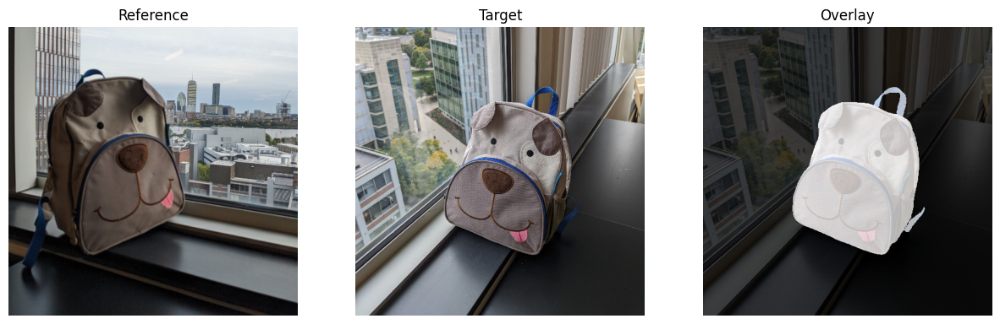

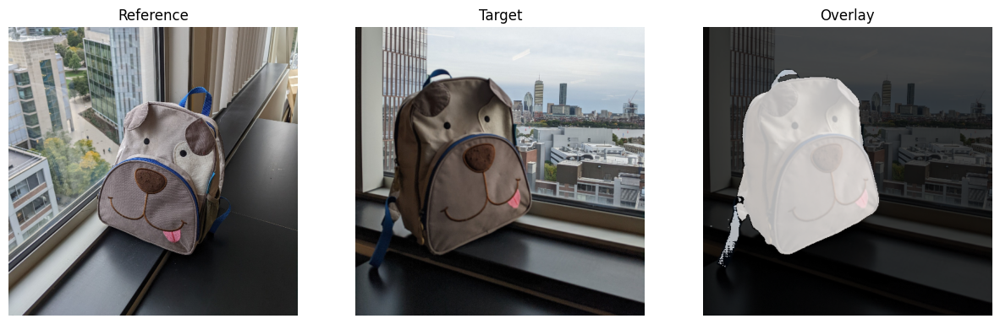

Evaluating : /kaggle/input/cv-assgn3/Images/clock


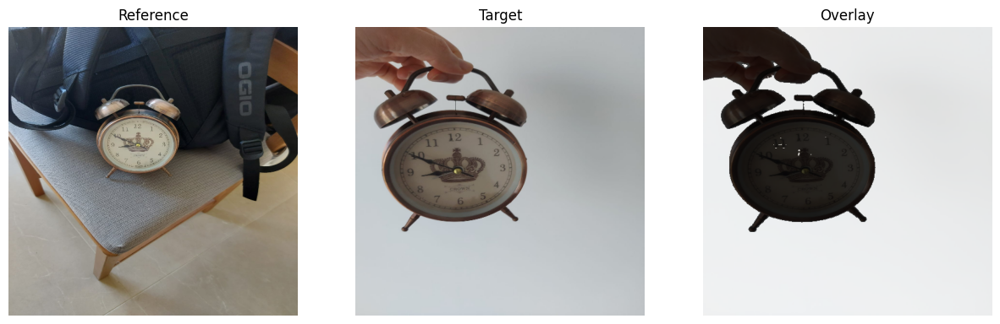

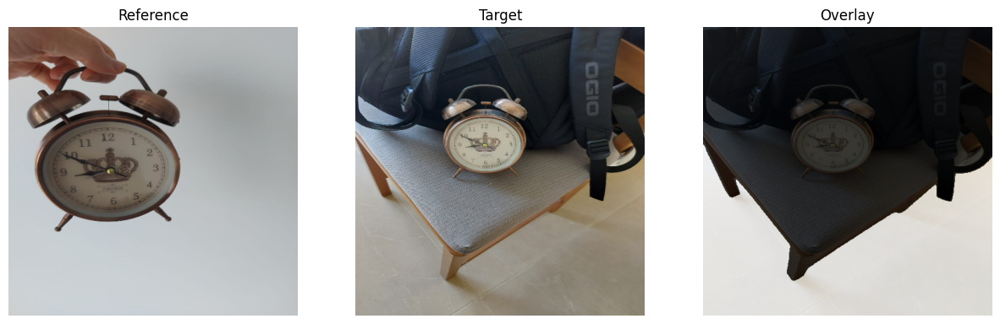

Evaluating : /kaggle/input/cv-assgn3/Images/can


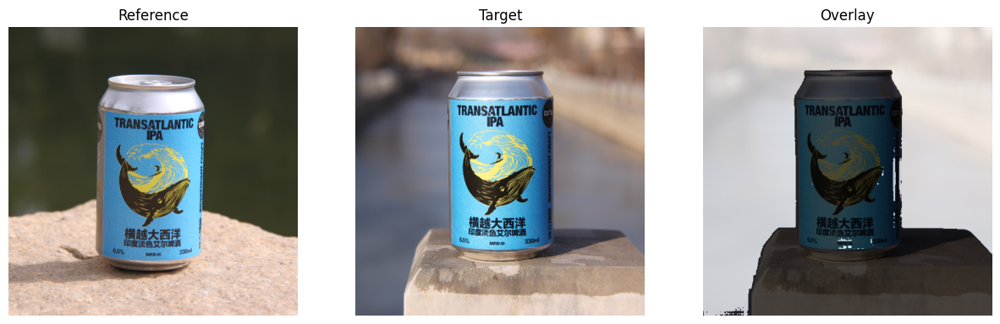

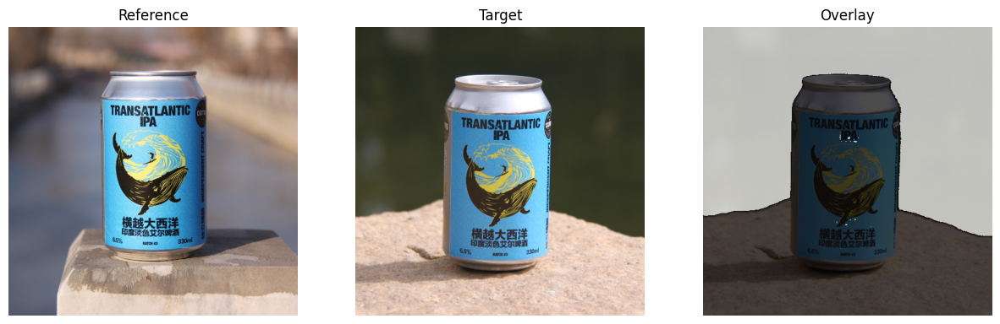

Evaluating : /kaggle/input/cv-assgn3/Images/berry_bowl


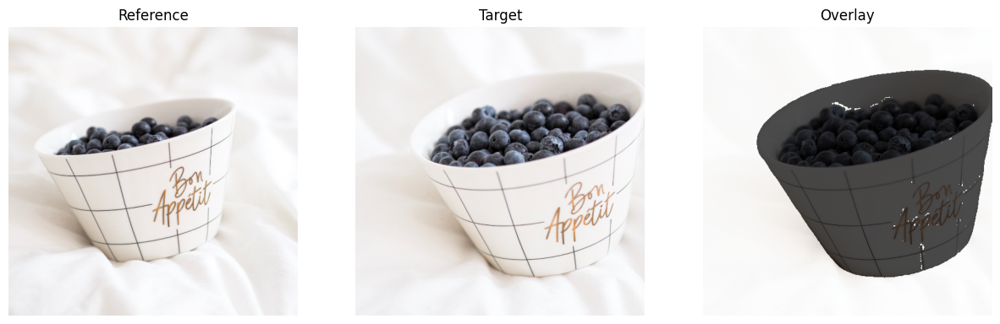

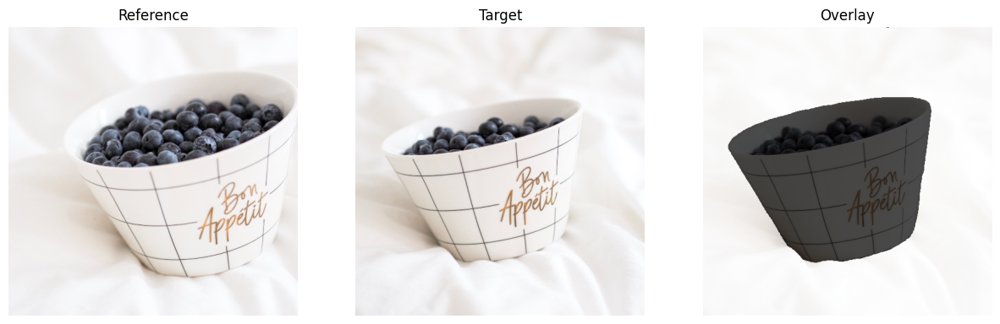

Evaluating : /kaggle/input/cv-assgn3/Images/candle


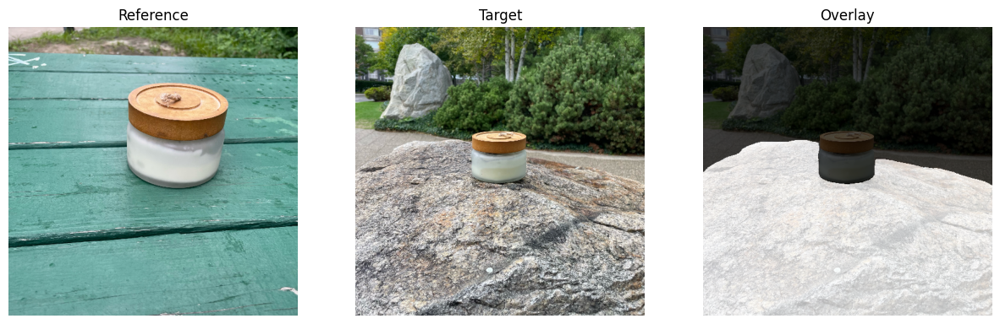

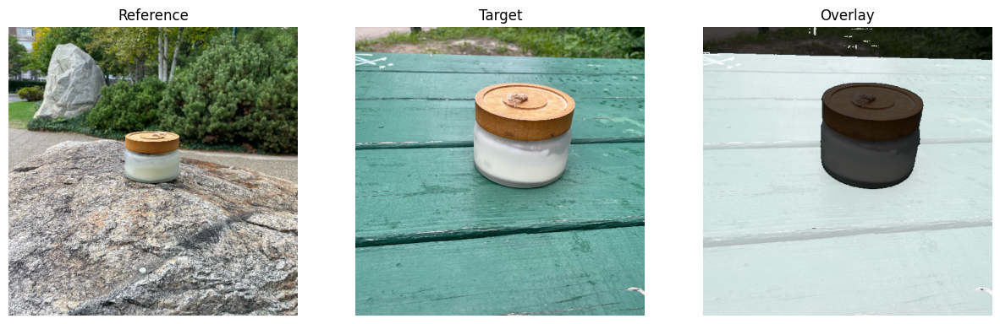

Evaluating : /kaggle/input/cv-assgn3/Images/barn


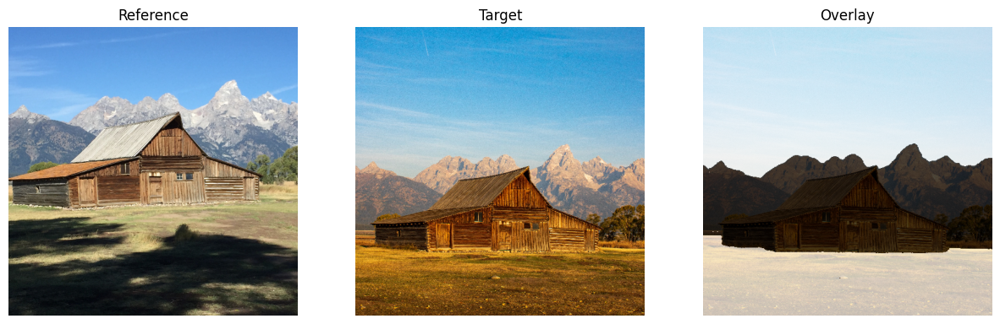

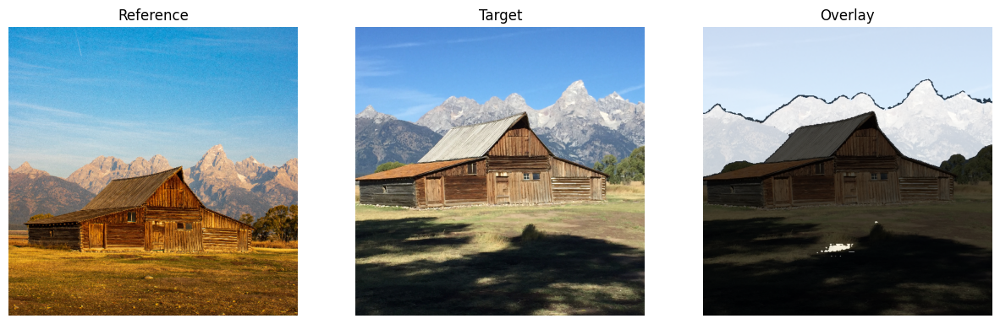

Evaluating : /kaggle/input/cv-assgn3/Images/dog


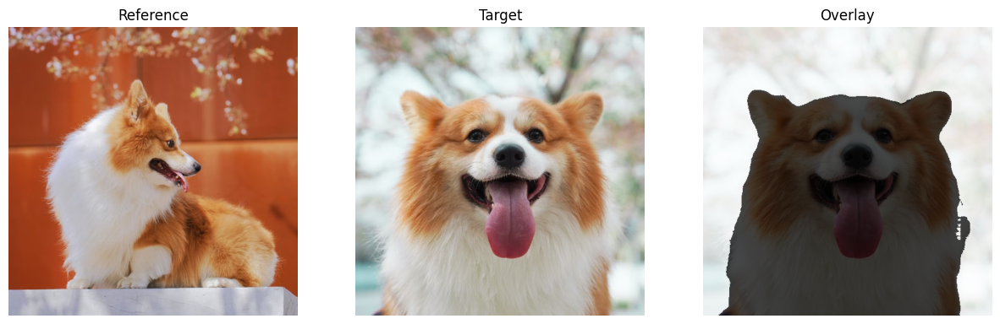

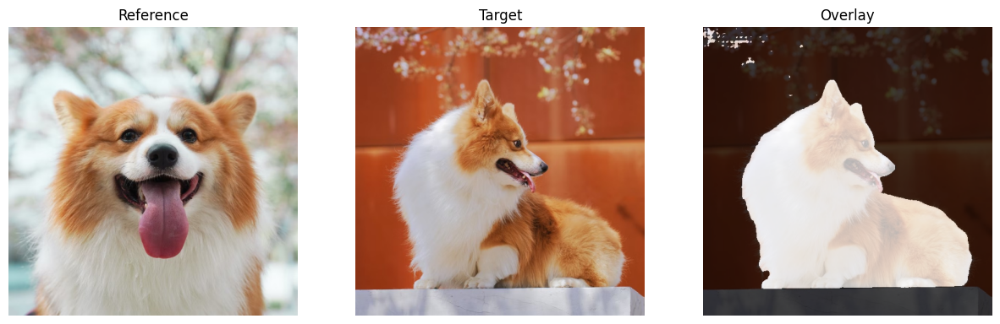

Evaluating : /kaggle/input/cv-assgn3/Images/dog3


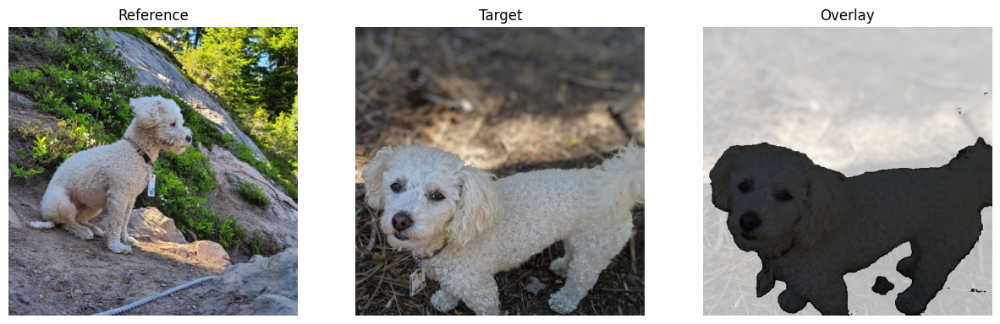

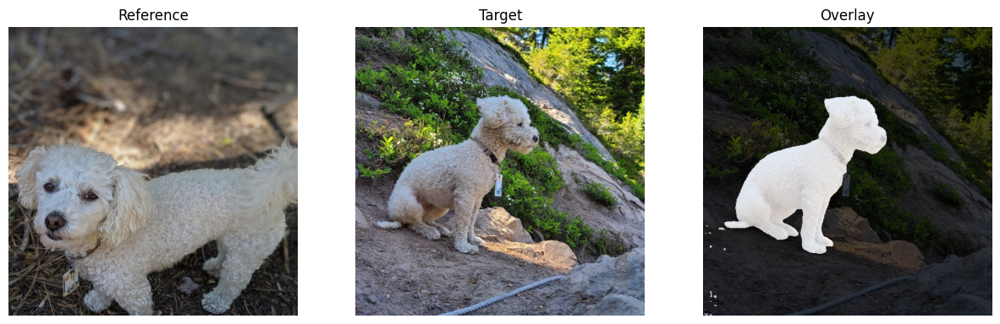

Evaluating : /kaggle/input/cv-assgn3/Images/colorful_teapot


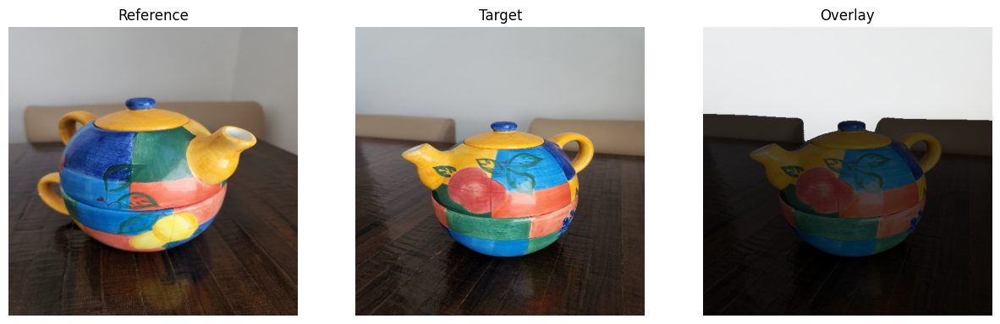

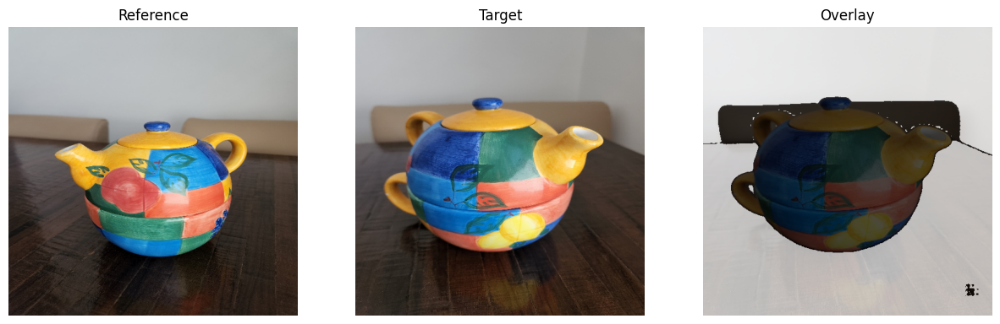

Evaluating : /kaggle/input/cv-assgn3/Images/bear_plushie


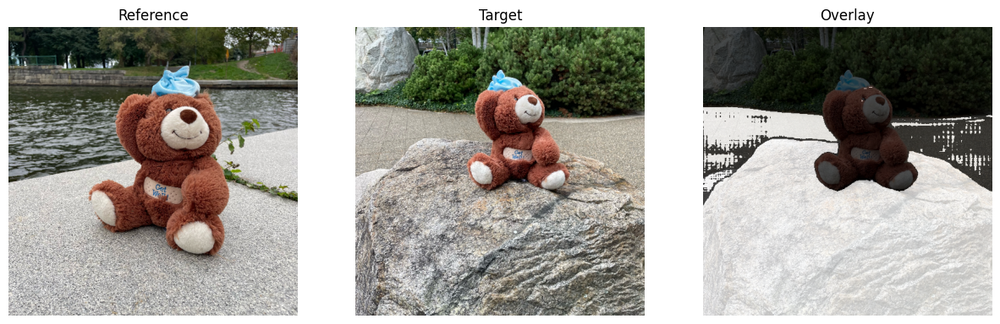

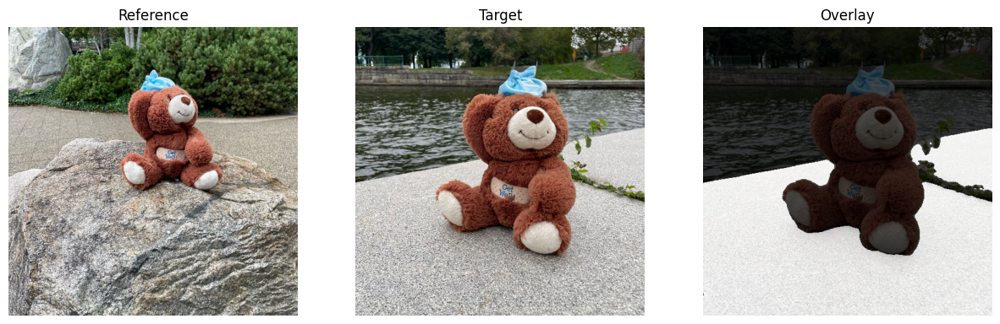

Evaluating : /kaggle/input/cv-assgn3/Images/cat2


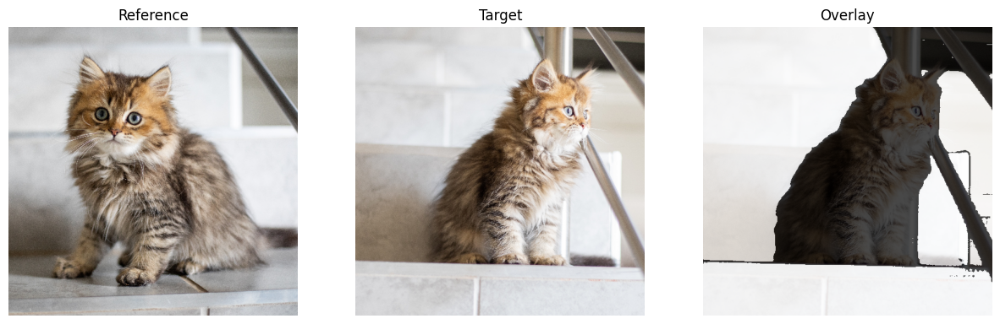

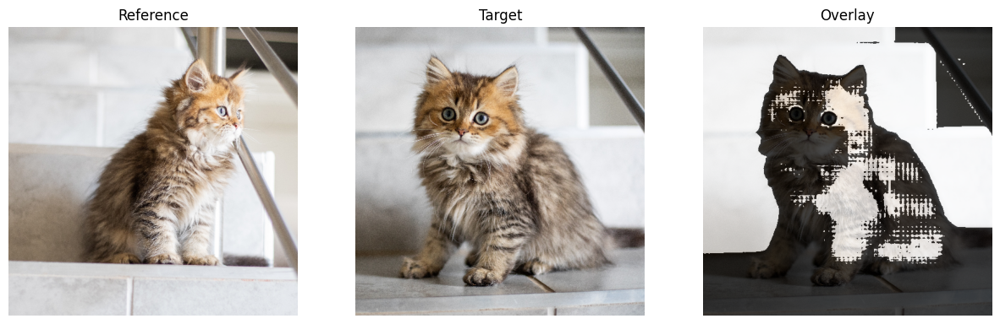

Evaluating : /kaggle/input/cv-assgn3/Images/cat_statue


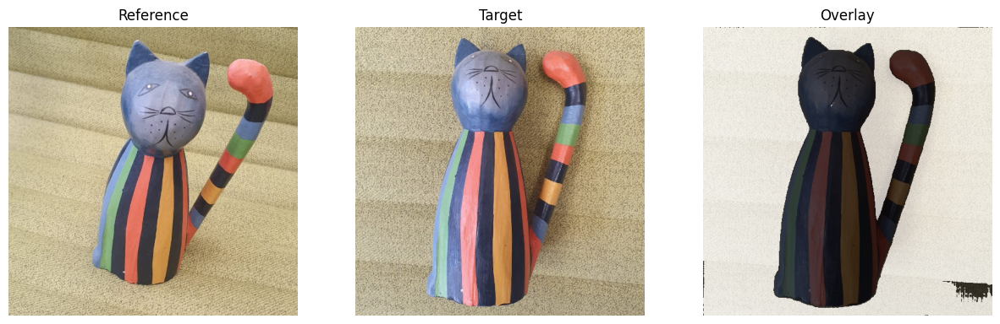

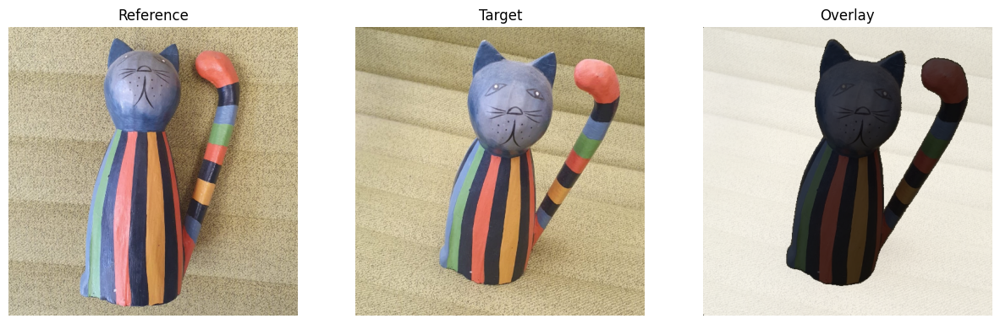

Evaluating : /kaggle/input/cv-assgn3/Images/colorful_sneaker


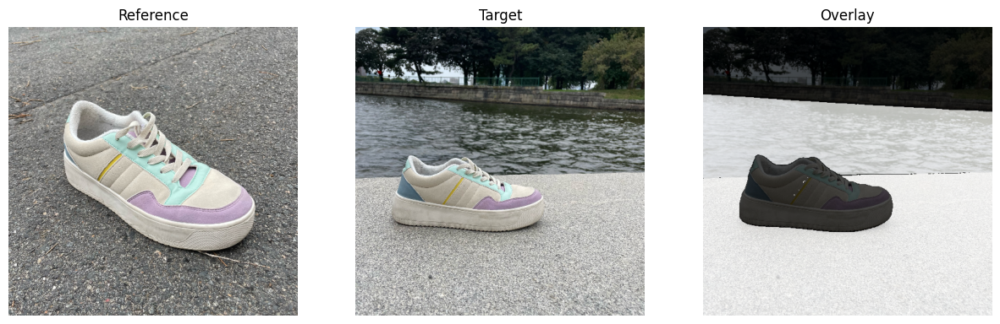

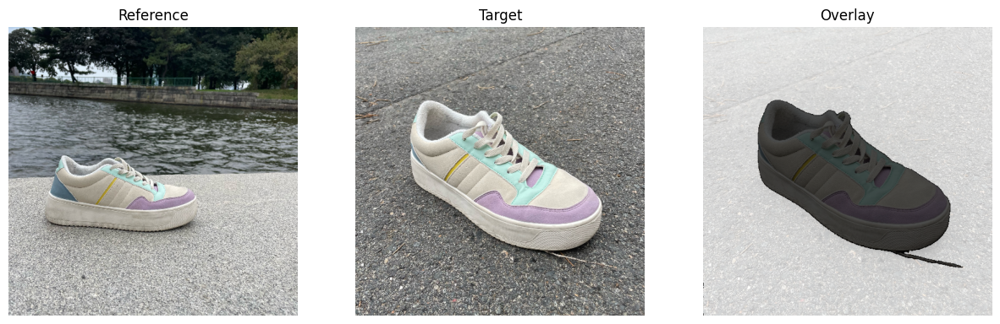

Evaluating : /kaggle/input/cv-assgn3/Images/chair


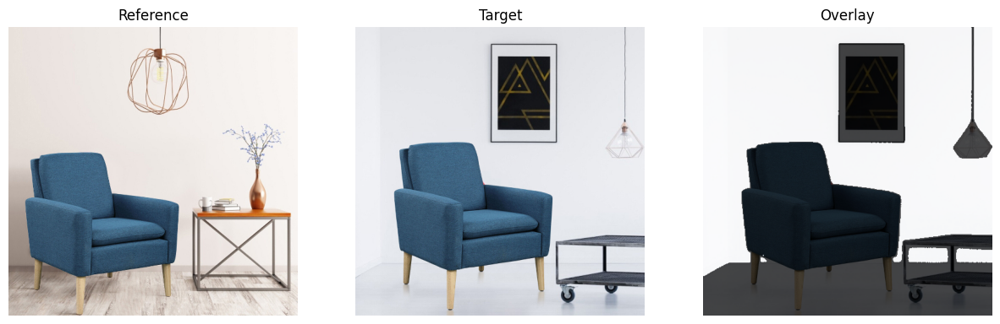

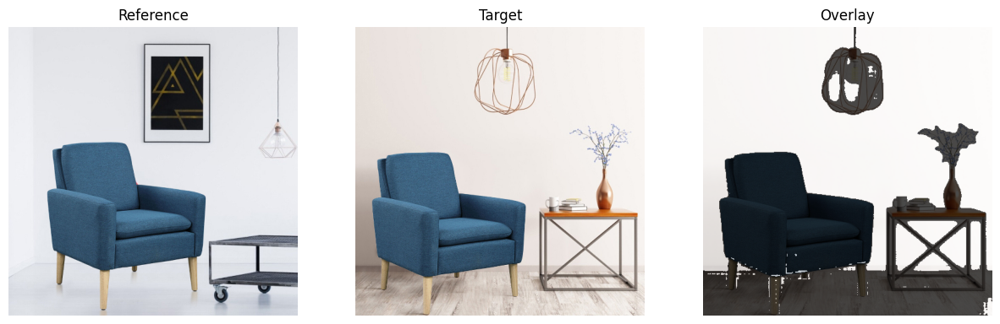

Evaluating : /kaggle/input/cv-assgn3/Images/dog2


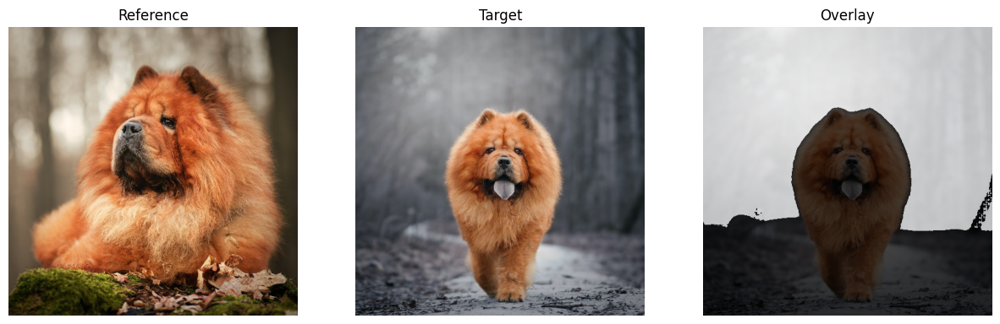

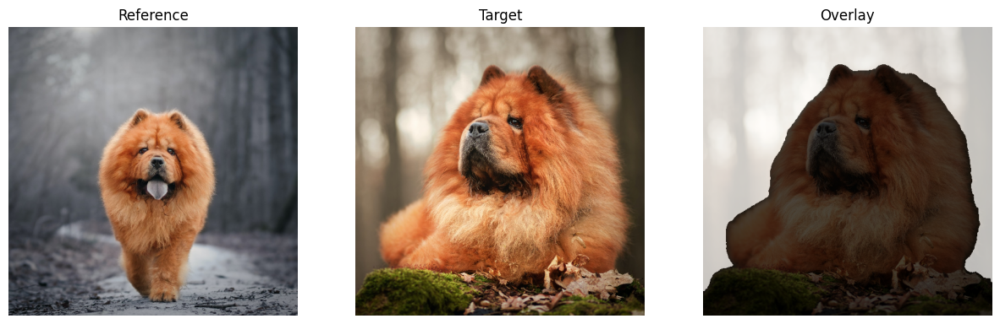

Evaluating : /kaggle/input/cv-assgn3/Images/cat


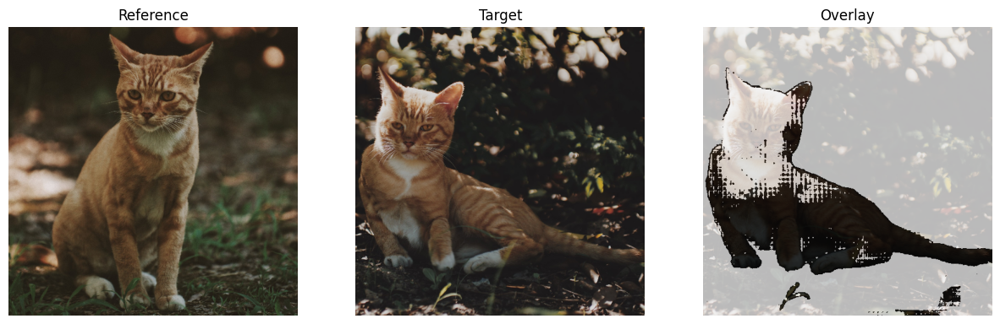

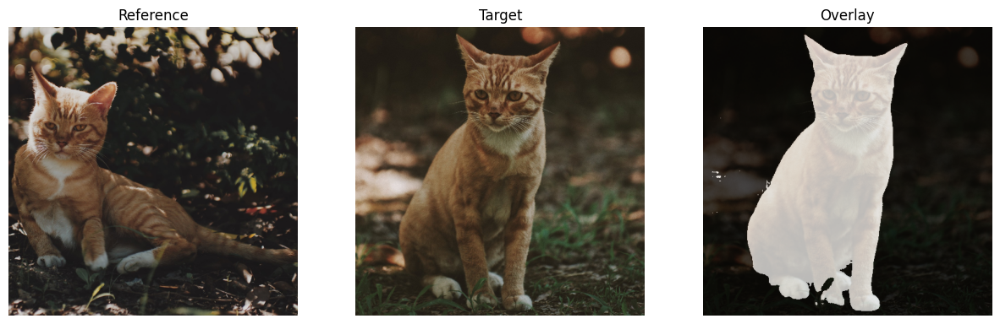

Evaluating : /kaggle/input/cv-assgn3/Images/backpack


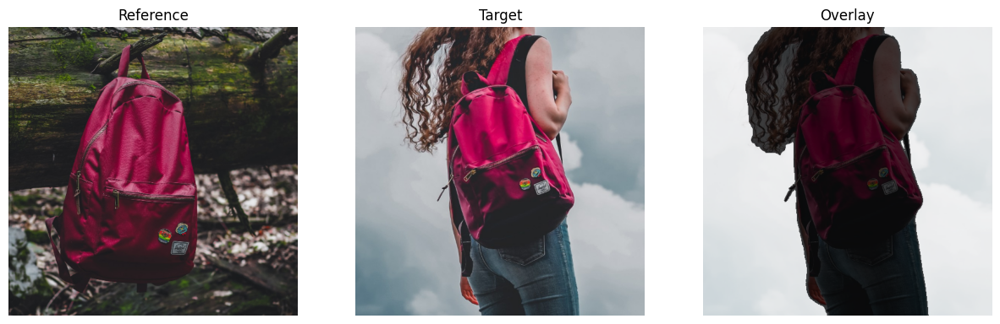

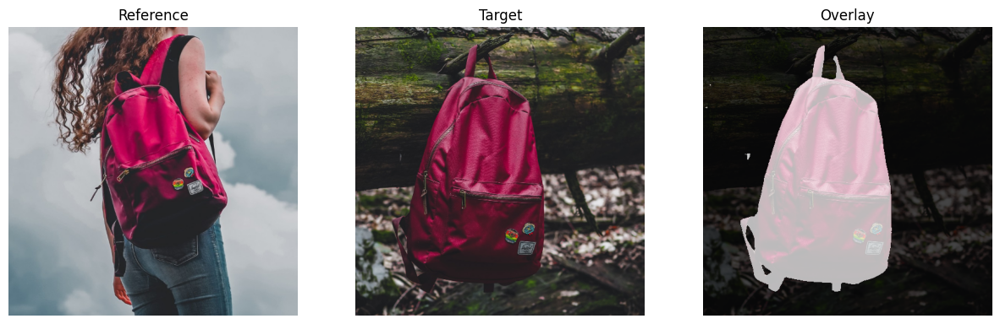

In [62]:
import os
import glob

def evaluate_matcher_on_images(images_folder):
    # Get a list of subfolders in the images folder
    subfolders = [f.path for f in os.scandir(images_folder) if f.is_dir()]

    # Loop through each subfolder
    for subfolder in subfolders:
        # Get all images in the subfolder
        image_files = glob.glob(os.path.join(subfolder, "*.jpg"))
        
        # Ensure there are exactly two images in the folder
        if len(image_files) == 2:
            # Get reference and target images
            ref_img, tgt_img = image_files

            print(f"Evaluating : {subfolder}")
            
            # Call the demo function to evaluate the matcher
            demo(ref_img, tgt_img)
            demo(tgt_img, ref_img)

# Define the path to the images folder
images_folder = "/kaggle/input/cv-assgn3/Images"

# Evaluate the matcher on all images in the folder
evaluate_matcher_on_images(images_folder)
